# Exploratory Data Analysis

## METADATA:

# 📊 Metadata: Bank Marketing Dataset (with Social/Economic Context)

## 1. Title
**Bank Marketing (with social/economic context)**

---

## 2. Sources
- Created by: Sérgio Moro (ISCTE-IUL), Paulo Cortez (Universidade do Minho), and Paulo Rita (ISCTE-IUL)
- Year: 2014

---

## 3. Past Usage
The dataset was analyzed in the following paper:

> Moro, S., Cortez, P., & Rita, P. (2014).  
> *A Data-Driven Approach to Predict the Success of Bank Telemarketing*.  
> Decision Support Systems. https://doi.org/10.1016/j.dss.2014.03.001

---

## 4. Relevant Information

- Based on the UCI "Bank Marketing" dataset: [UCI Link](http://archive.ics.uci.edu/ml/datasets/Bank+Marketing)
- Enriched with **5 new social and economic attributes** from Banco de Portugal: [Source](https://www.bportugal.pt/estatisticasweb)
- Closely matches the dataset used in Moro et al. (2014), with slight modifications for privacy.
- Demonstrated improved predictive performance using `rminer` (R) even without using the `duration` variable.
- Provided as two files:
  1. `bank-additional-full.csv` – all examples (41,188 rows), sorted by date from May 2008 to Nov 2010.
  2. `bank-additional.csv` – 10% random sample (4,119 rows), useful for heavier ML algorithms like SVM.

**Target Variable**:  
Binary classification task — predict if the client subscribes to a term deposit (`y`).

---

## 5. Number of Instances
- **41,188** (in `bank-additional-full.csv`)

---

## 6. Number of Attributes
- **20 input features** + **1 target attribute (`y`)**

---

## 7. Attribute Information

### 📥 Input Variables

#### Bank Client Data:
1. `age` (numeric)  
2. `job` (categorical)  
   > "admin.","blue-collar","entrepreneur","housemaid","management","retired","self-employed","services","student","technician","unemployed","unknown"  
3. `marital` (categorical)  
   > "divorced","married","single","unknown"  
4. `education` (categorical)  
   > "basic.4y","basic.6y","basic.9y","high.school","illiterate","professional.course","university.degree","unknown"  
5. `default` – credit in default? (categorical: "no","yes","unknown")  
6. `housing` – housing loan? (categorical: "no","yes","unknown")  
7. `loan` – personal loan? (categorical: "no","yes","unknown")  

#### Contact Info (Last Campaign):
8. `contact` (categorical: "cellular","telephone")  
9. `month` (categorical: "jan"–"dec")  
10. `day_of_week` (categorical: "mon"–"fri")  
11. `duration` (numeric, seconds)  
> ⚠️ Highly affects the outcome. Use only for benchmarking; exclude for realistic prediction.

#### Other Attributes:
12. `campaign` – number of contacts in current campaign (numeric)  
13. `pdays` – days since last contact (numeric, 999 = never contacted)  
14. `previous` – number of previous contacts (numeric)  
15. `poutcome` – outcome of previous campaign (categorical: "failure","nonexistent","success")  

#### Social & Economic Context:
16. `emp.var.rate` – employment variation rate (quarterly, numeric)  
17. `cons.price.idx` – consumer price index (monthly, numeric)  
18. `cons.conf.idx` – consumer confidence index (monthly, numeric)  
19. `euribor3m` – 3-month Euribor rate (daily, numeric)  
20. `nr.employed` – number of employees (quarterly, numeric)  

### 🎯 Output Variable
21. `y` – Has the client subscribed a term deposit?  
> Binary: `"yes"` or `"no"`

---

## 8. Missing Attribute Values
- Several **categorical attributes contain `"unknown"`** values.
- These can be:
  - Treated as a separate category
  - Imputed
  - Filtered out, depending on the modeling strategy


### 1. Imports

In [2]:
import pandas as pd
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency

#report
import sweetviz as sv

<hr>
<hr>

## 1.1 Loading Dataset

In [3]:
df = pd.read_csv("bank-additional-full.csv", sep=";")

<hr>
<hr>

## <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2. EDA</b>

- **[2.1. General Overview](#Data-Types)**
- **[2.2. Missing Values](#Data-Types)**
- **[2.3. Numerical Analysis](#Descriptive-Summary)**
- **[2.4. Categorical Analysis](#Descriptive-Summary)**
- **[2.6. Pairwise Analysis](#Descriptive-Summary)**
- **[2.7. Duplicates](#Descriptive-Summary)**
- **[2.8. Outliers](#Descriptive-Summary)**

#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.1 General Overview</b>

In [4]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [36]:
df.shape

(41188, 21)

#### Structure of the Dataset:

In [6]:
print(df.columns)
print("-------------------")
print(df.dtypes)
print("-------------------")


Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')
-------------------
age                 int64
job                object
marital            object
education          object
default            object
housing            object
loan               object
contact            object
month              object
day_of_week        object
duration            int64
campaign            int64
pdays               int64
previous            int64
poutcome           object
emp.var.rate      float64
cons.price.idx    float64
cons.conf.idx     float64
euribor3m         float64
nr.employed       float64
y                  object
dtype: object
-------------------


#### General Information (Data Types)

In [7]:
print(df.info())
print("-------------------")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

#### Target Variable:

- Imbalanced Dataset -> Binary Classification

In [8]:
df["y"].value_counts(normalize=True)

y
no     0.887346
yes    0.112654
Name: proportion, dtype: float64

<hr>
<hr>

#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.2 Missing Values Analysis</b>

In [39]:
df.isnull().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
dtype: int64

In [47]:
unknown_counts = (df == "unknown").sum()
unknown_columns = unknown_counts[unknown_counts > 0]
print(unknown_columns)


job           330
marital        80
education    1731
default      8597
housing       990
loan          990
dtype: int64


<hr>
<hr>

#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.3 Numerical Analysis</b>

In [15]:
numeric = df.select_dtypes(include=["int64", "float64"]).columns
print(numeric)


Index(['age', 'duration', 'campaign', 'pdays', 'previous', 'emp.var.rate',
       'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed'],
      dtype='object')


In [17]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


#### Age Feature

In [21]:
df["age"].value_counts(normalize=True)

age
31    0.047271
32    0.044819
33    0.044503
36    0.043216
35    0.042707
        ...   
89    0.000049
91    0.000049
94    0.000024
87    0.000024
95    0.000024
Name: proportion, Length: 78, dtype: float64

In [56]:
fig = ff.create_distplot([df["age"]], group_labels=["Age"], bin_size=2, show_hist=True, show_curve=True)
fig.update_layout(title="Age Distribution with KDE Trend Line")
fig.show()

In [35]:
px.box(df, x="age", y="y", title="Age Distribution by Subscription").update_xaxes(categoryorder="total ascending").show()

<hr>

#### Duration

In [43]:
df["duration"].value_counts(normalize=True)

duration
90      0.004127
85      0.004127
136     0.004079
73      0.004055
124     0.003982
          ...   
1569    0.000024
1053    0.000024
1263    0.000024
1169    0.000024
1868    0.000024
Name: proportion, Length: 1544, dtype: float64

In [ ]:
fig = ff.create_distplot([df["duration"]], group_labels=["duration"], bin_size=2, show_hist=True, show_curve=True)
fig.update_layout(title="Duration Distribution with KDE Trend Line")
fig.show()

- High Skew

In [58]:
px.box(df, x="duration", y="y", title="Duration Distribution by Subscription").update_xaxes(categoryorder="total ascending").show()

#### Campaign - Number of contacts in current campaign

In [59]:
df["campaign"].value_counts(normalize=True)

campaign
1     0.428329
2     0.256628
3     0.129674
4     0.064363
5     0.038822
6     0.023769
7     0.015271
8     0.009712
9     0.006871
10    0.005463
11    0.004297
12    0.003035
13    0.002234
14    0.001675
17    0.001408
16    0.001238
15    0.001238
18    0.000801
20    0.000728
19    0.000631
21    0.000583
22    0.000413
23    0.000388
24    0.000364
27    0.000267
29    0.000243
28    0.000194
26    0.000194
25    0.000194
31    0.000170
30    0.000170
35    0.000121
32    0.000097
33    0.000097
34    0.000073
42    0.000049
40    0.000049
43    0.000049
56    0.000024
39    0.000024
41    0.000024
37    0.000024
Name: proportion, dtype: float64

- Some values here seem quite extreme for number of contacts

In [61]:
fig = ff.create_distplot([df["campaign"]], group_labels=["campaign"], bin_size=2, show_hist=True, show_curve=True)
fig.update_layout(title="Campaign Distribution with KDE Trend Line")
fig.show()

In [63]:
px.box(df, x="campaign", y="y", title="Campaign Boxplot by Subscription").update_xaxes(categoryorder="total ascending").show()

<hr>

#### Pdays - Previous days since last contact

Note: "999" - Never contacted

In [64]:
df["pdays"].value_counts(normalize=True)

pdays
999    0.963217
3      0.010658
6      0.010003
4      0.002865
9      0.001554
2      0.001481
7      0.001457
12     0.001408
10     0.001263
5      0.001117
13     0.000874
11     0.000680
1      0.000631
15     0.000583
14     0.000486
8      0.000437
0      0.000364
16     0.000267
17     0.000194
18     0.000170
22     0.000073
19     0.000073
21     0.000049
25     0.000024
26     0.000024
27     0.000024
20     0.000024
Name: proportion, dtype: float64

In [79]:
fig = ff.create_distplot([df["pdays"]], group_labels=["pdays"], bin_size=2, show_hist=True, show_curve=True)
fig.update_layout(title="Pdays Distribution with KDE Trend Line")
fig.show()

- Possibility to treat this variable as categorical in Feat.Engineering: 1 for contact; 0 for no contact

<hr>

#### Previous - Number of Previous Contacts

In [81]:
df["previous"].value_counts(normalize=True)

previous
0    0.863431
1    0.110736
2    0.018306
3    0.005244
4    0.001700
5    0.000437
6    0.000121
7    0.000024
Name: proportion, dtype: float64

In [86]:
previous_counts = df["previous"].value_counts().sort_index()

# Plot as bar chart
px.bar(
    x=previous_counts.index,
    y=previous_counts.values,
    labels={"x": "Previous", "y": "Count"},
    title="Bar Chart: Previous - Value Counts"
).show()

- Also a possibility for Binning here -> 0: "0" ; "1": "1"; "2+": "MORE THAN 2 CONTACTS"

<hr>

#### Emp.Var.Rate

- Employment Variation Rate Quarterly

In [87]:
df["emp.var.rate"].value_counts(normalize=True)

emp.var.rate
 1.4    0.394144
-1.8    0.222978
 1.1    0.188477
-0.1    0.089419
-2.9    0.040376
-3.4    0.026003
-1.7    0.018768
-1.1    0.015417
-3.0    0.004176
-0.2    0.000243
Name: proportion, dtype: float64

In [91]:
px.box(
    df, 
    x="y", 
    y="emp.var.rate", 
    title="Employment Variation Rate by Subscription Outcome",
    labels={"y": "Subscribed", "emp.var.rate": "Employment Variation Rate"}
).show()

<hr>

#### Cons.Price.Idx - Consumer Price Index Monthly Indicator

In [96]:
df["cons.price.idx"].value_counts(normalize=True)

cons.price.idx
93.994    0.188477
93.918    0.162305
92.893    0.140672
93.444    0.125643
94.465    0.106196
93.200    0.087793
93.075    0.059678
92.201    0.018695
92.963    0.017359
92.431    0.010853
92.649    0.008668
94.215    0.007551
94.199    0.007357
92.843    0.006847
92.379    0.006482
93.369    0.006410
94.027    0.005657
94.055    0.005560
93.876    0.005147
94.601    0.004953
92.469    0.004322
93.749    0.004225
92.713    0.004176
94.767    0.003108
93.798    0.001627
92.756    0.000243
Name: proportion, dtype: float64

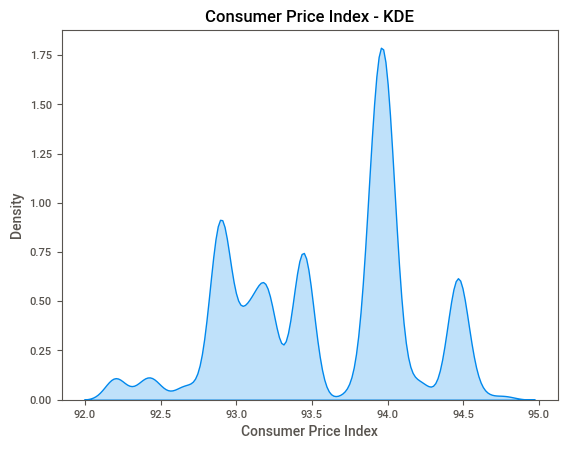

In [ ]:
sns.kdeplot(df["cons.price.idx"], fill=True)
plt.title("Consumer Price Index - KDE")
plt.xlabel("Consumer Price Index")
plt.ylabel("Density")
plt.show()

In [105]:
px.box(
    df, 
    x="y", 
    y="cons.price.idx", 
    title="Consumer Price Index by Subscription Outcome",
    labels={"y": "Subscribed", "cons.price.idx": "Consumer Price Index"}
).show()

<hr>

#### Consumer Confidence Index - Monthly Indicator

In [102]:
df["cons.conf.idx"].value_counts(normalize=True)

cons.conf.idx
-36.4    0.188477
-42.7    0.162305
-46.2    0.140672
-36.1    0.125643
-41.8    0.106196
-42.0    0.087793
-47.1    0.059678
-31.4    0.018695
-40.8    0.017359
-26.9    0.010853
-30.1    0.008668
-40.3    0.007551
-37.5    0.007357
-50.0    0.006847
-29.8    0.006482
-34.8    0.006410
-38.3    0.005657
-39.8    0.005560
-40.0    0.005147
-49.5    0.004953
-33.6    0.004322
-34.6    0.004225
-33.0    0.004176
-50.8    0.003108
-40.4    0.001627
-45.9    0.000243
Name: proportion, dtype: float64

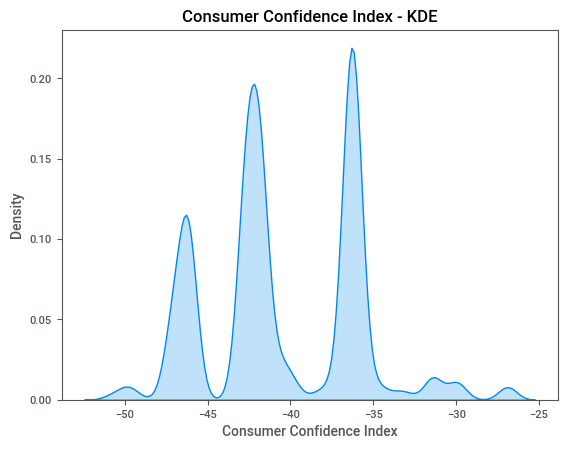

In [103]:
sns.kdeplot(df["cons.conf.idx"], fill=True)
plt.title("Consumer Confidence Index - KDE")
plt.xlabel("Consumer Confidence Index")
plt.ylabel("Density")
plt.show()

In [ ]:
px.box(
    df, 
    x="y", 
    y="cons.conf.idx", 
    title="Consumer Confidence Index by Subscription Outcome",
    labels={"y": "Subscribed", "cons.conf.idx": "Consumer Confidence Index"}
).show()

<hr>

#### Euribor 3 Month Rate - Daily Indicator

In [107]:
df["euribor3m"].value_counts(normalize=True)

euribor3m
4.857    0.069632
4.962    0.063441
4.963    0.060382
4.961    0.046178
4.856    0.029377
           ...   
3.853    0.000024
3.901    0.000024
0.969    0.000024
0.956    0.000024
3.669    0.000024
Name: proportion, Length: 316, dtype: float64

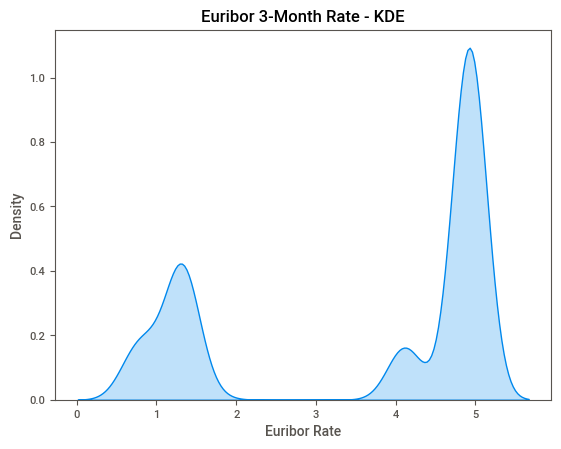

In [109]:

sns.kdeplot(df["euribor3m"], fill=True)
plt.title("Euribor 3-Month Rate - KDE")
plt.xlabel("Euribor Rate")
plt.ylabel("Density")
plt.show()


In [108]:
px.histogram(
    df,
    x="euribor3m",
    nbins=30,
    title="Distribution of Euribor 3-Month Rate",
    labels={"euribor3m": "Euribor 3-Month Rate"}
).show()

#### Number Employed - Number of Employees

In [110]:
df["nr.employed"].value_counts(normalize=True)

nr.employed
5228.1    0.394144
5099.1    0.207196
5191.0    0.188477
5195.8    0.089419
5076.2    0.040376
5017.5    0.026003
4991.6    0.018768
5008.7    0.015781
4963.6    0.015417
5023.5    0.004176
5176.3    0.000243
Name: proportion, dtype: float64

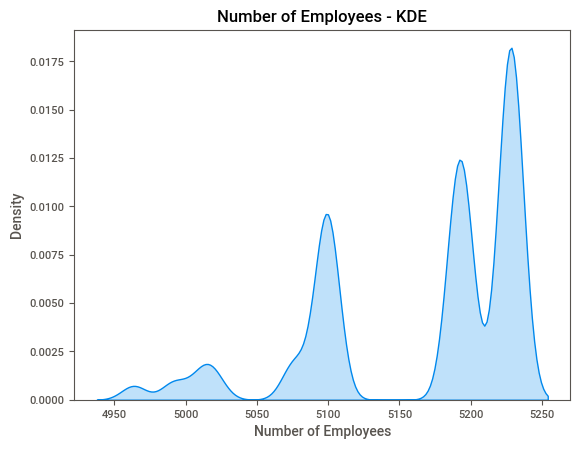

In [114]:
sns.kdeplot(df["nr.employed"], fill=True)
plt.title("Number of Employees - KDE")
plt.xlabel("Number of Employees")
plt.ylabel("Density")
plt.show()

In [113]:
px.box(
    df, 
    x="y", 
    y="nr.employed",
    title="Number of Employees by Subscription Outcome",
    labels={"y": "Subscribed", "nr.employed": "Number of Employees"}
).show()

<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.4 Categorical Analysis</b>

In [6]:
categorical = df.select_dtypes(include=["object"]).columns
print(categorical)

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'day_of_week', 'poutcome', 'y'],
      dtype='object')


In [132]:
def plot_categorical_summary(df, target_col="y"):
    categorical_cols = df.select_dtypes(include="object").columns.tolist()
    categorical_cols = [col for col in categorical_cols if col != target_col]

    for col in categorical_cols:
        print(f"📊 Plotting: {col}")

        # Sort order based on total frequency
        col_order = df[col].value_counts().index.tolist()

        # Grouped bar plot by target
        fig1 = px.histogram(
            df,
            x=col,
            color=target_col,
            barmode="group",
            title=f"{col.title()} vs {target_col.title()}",
            category_orders={col: col_order},
            labels={col: col.title(), target_col: target_col.title()}
        )
        fig1.show()

        # Simple value counts bar plot
        counts = df[col].value_counts()
        fig2 = px.bar(
            x=counts.index,
            y=counts.values,
            labels={"x": col.title(), "y": "Count"},
            title=f"Bar Chart: {col.title()} - Value Counts"
        )
        fig2.show()

<hr>

#### **Categorical Variables Bar Charts - Distribution**

In [133]:
plot_categorical_summary(df, target_col="y")


📊 Plotting: job


📊 Plotting: marital


📊 Plotting: education


📊 Plotting: default


📊 Plotting: housing


📊 Plotting: loan


📊 Plotting: contact


📊 Plotting: month


📊 Plotting: day_of_week


📊 Plotting: poutcome


<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.5 Pairwise Analysis</b>

#### Euribor 3 Month Rate - Daily indicator with Month

In [134]:
month_order = [
    "jan", "feb", "mar", "apr", "may", "jun",
    "jul", "aug", "sep", "oct", "nov", "dec"
]

df["month"] = pd.Categorical(df["month"], categories=month_order, ordered=True)

In [135]:
euribor_monthly = df.groupby("month")["euribor3m"].mean().reset_index()
px.line(
    euribor_monthly,
    x="month",
    y="euribor3m",
    title="Average Euribor 3-Month Rate by Month",
    labels={"month": "Month", "euribor3m": "Average Euribor 3-Month Rate"}
).show()

/var/folders/g5/ywgc2st561vdz7yhpz3m2chh0000gn/T/ipykernel_7279/3934808336.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



<hr>

#### Social & Economic Context Relationships

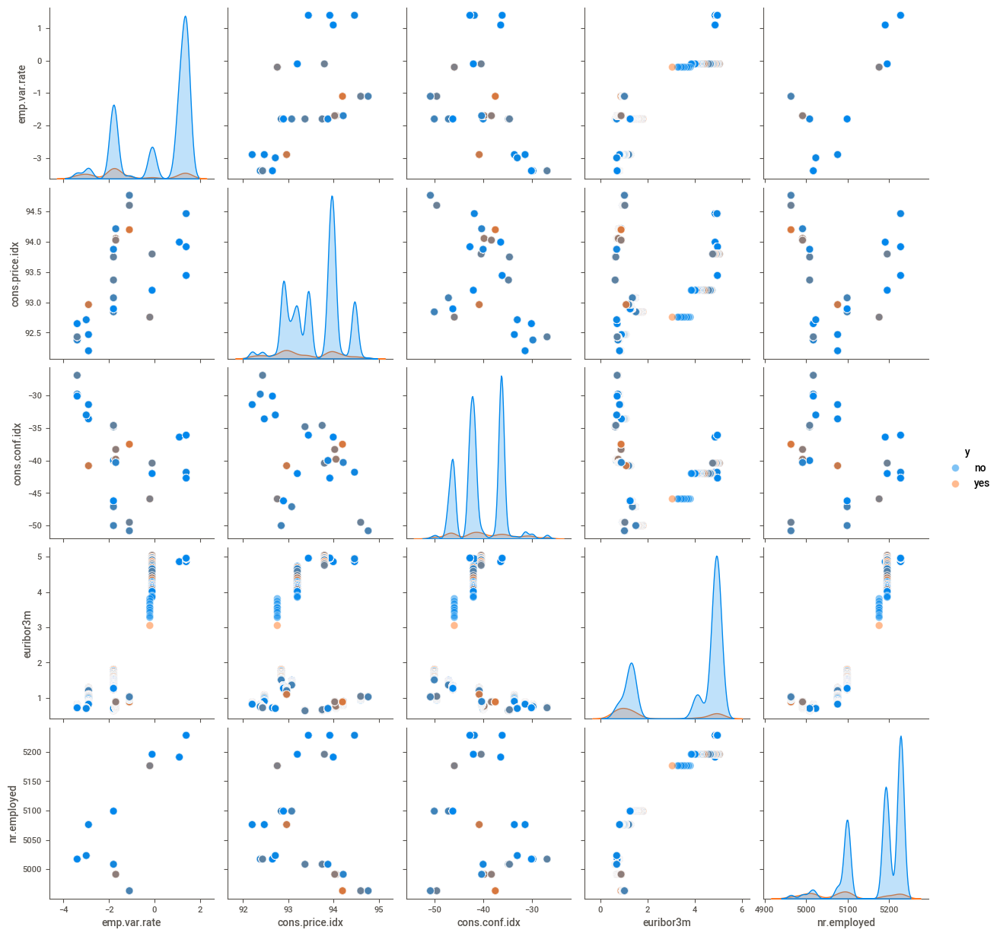

In [ ]:
sns.pairplot(
    df,
    vars=["emp.var.rate", "cons.price.idx", "cons.conf.idx", "euribor3m", "nr.employed"],
    hue="y",
    diag_kind="kde",
    plot_kws={"alpha": 0.5, "s": 50},
)

- Initial Problem: Most numeric values appear to be discrete buckets rather than continuous. 
- No clear linear relationships nor strong separability between classes.

#### Temporal Patterns

In [28]:
df["y_binary"] = df["y"].map({"no": 0, "yes": 1})
subscription_month = df.groupby("month")["y_binary"].mean().reset_index()
px.line(
    subscription_month,
    x="month",
    y="y_binary",
    title="Subscription Rate by Month",
    labels={"month": "Month", "y_binary": "Subscription Rate"},
    markers=True
).show()

#### Day_of_week - Identify best days to contact

In [30]:
subscription_day = df.groupby("day_of_week")["y_binary"].mean().reset_index()

overall_mean = df["y_binary"].mean()

fig = px.bar(subscription_day, x="day_of_week", y="y_binary", title="Subscription Rate by Day of Week")
fig.add_hline(
    y=overall_mean,
    line_dash="dot",
    line_color="red",
    annotation_text="Overall Mean",
    annotation_position="top right"
)
fig.show()

<hr>

#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;"> 2.6.1. Correlation Heatmap</b>

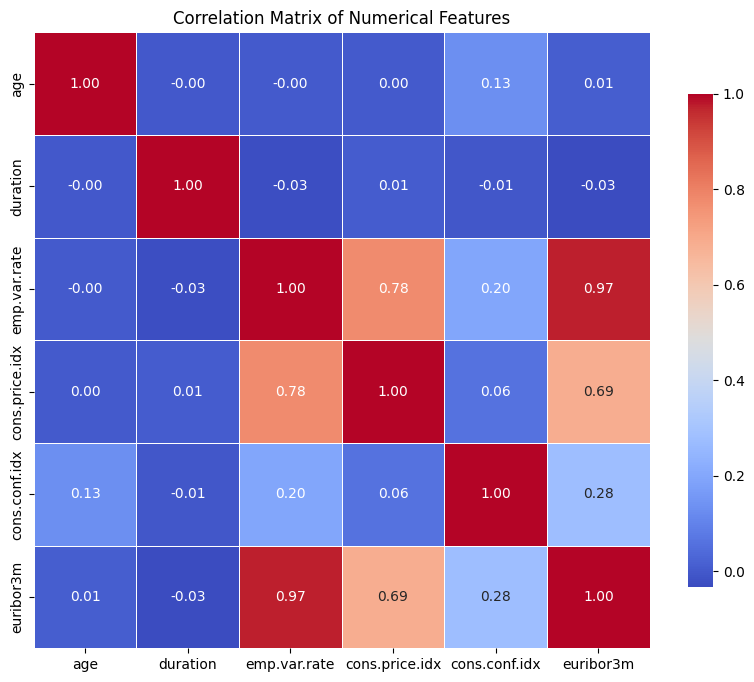

In [26]:
numerical_df = df.select_dtypes(include=["float64", "int64"])
continuous_cols = ["age", "duration", "emp.var.rate", "cons.price.idx", "cons.conf.idx", "euribor3m"]

corr_matrix = numerical_df[continuous_cols].corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(
    corr_matrix,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.8}
)
plt.title("Correlation Matrix of Numerical Features")
plt.show()


- Note: Some correlated features mainly emp.var.rate

<hr>

#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;"> 2.6.1. Statistical Significance</b>

In [147]:
def ttest_numerical_vs_target(df, target_col="y", alpha=0.05):
    numerical_cols = df.select_dtypes(include=["int64", "float64"]).columns.tolist()
    
    results = []
    
    for col in numerical_cols:
        group_yes = df[df[target_col] == "yes"][col].dropna()
        group_no = df[df[target_col] == "no"][col].dropna()
        
        if len(group_yes) > 1 and len(group_no) > 1:
            t_stat, p_val = ttest_ind(group_yes, group_no, equal_var=False)
            results.append({
                "feature": col,
                "t_statistic": round(t_stat, 3),
                "p_value": round(p_val, 5),
                "significant": "Yes" if p_val < alpha else "No"
            })
    
    results_df = pd.DataFrame(results).sort_values(by="p_value")
    return results_df

In [148]:
ttest_results = ttest_numerical_vs_target(df, target_col="y")
print(ttest_results)


          feature  t_statistic  p_value significant
0             age        4.780      0.0         Yes
1        duration       55.500      0.0         Yes
2        campaign      -20.249      0.0         Yes
3           pdays      -32.251      0.0         Yes
4        previous       28.126      0.0         Yes
5    emp.var.rate      -59.137      0.0         Yes
6  cons.price.idx      -24.082      0.0         Yes
7   cons.conf.idx        8.636      0.0         Yes
8       euribor3m      -62.580      0.0         Yes
9     nr.employed      -60.975      0.0         Yes


#### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;"> 2.6.2. Chi-2 Test - Categorical Features</b>

In [ ]:
for col in categorical:
    table = pd.crosstab(df[col], df["y"])
    chi2, p, _, _ = chi2_contingency(table)
    print(f"{col}: p = {p:.4f}")

job: p = 0.0000
marital: p = 0.0000
education: p = 0.0000
default: p = 0.0000
housing: p = 0.0583
loan: p = 0.5787
contact: p = 0.0000
month: p = 0.0000
day_of_week: p = 0.0000
poutcome: p = 0.0000
y: p = 0.0000


- loan: Personal Loan "yes" or "no". Not significant.

<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.7 Duplicates</b>

In [8]:
duplicates = df.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

Number of duplicate rows: 12


In [10]:
df[df.duplicated(keep=False)]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
1265,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
1266,39,blue-collar,married,basic.6y,no,no,no,telephone,may,thu,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
12260,36,retired,married,unknown,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
12261,36,retired,married,unknown,no,no,no,telephone,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no
14155,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
14234,27,technician,single,professional.course,no,no,no,cellular,jul,mon,...,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16819,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
16956,47,technician,divorced,high.school,no,yes,no,cellular,jul,thu,...,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no
18464,32,technician,single,professional.course,no,yes,no,cellular,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no
18465,32,technician,single,professional.course,no,yes,no,cellular,jul,thu,...,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no


- 12 duplicated occurences; These must be eliminated in Preprocessing.

<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">2.8 Outliers</b>

In [14]:
def detect_iqr_outliers(df, multiplier=1.5):
    numeric_cols = df.select_dtypes(include=["float64", "int64"]).columns
    outlier_flags = pd.DataFrame(index=df.index)
    summary = []

    for col in numeric_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - multiplier * IQR
        upper_bound = Q3 + multiplier * IQR

        outlier_col = f"{col}_outlier"
        is_outlier = ((df[col] < lower_bound) | (df[col] > upper_bound)).astype(int)
        outlier_flags[outlier_col] = is_outlier

        summary.append({
            "feature": col,
            "lower_bound": lower_bound,
            "upper_bound": upper_bound,
            "outliers_count": is_outlier.sum(),
            "percent_outliers": round(is_outlier.mean() * 100, 2)
        })

    summary_df = pd.DataFrame(summary).sort_values(by="outliers_count", ascending=False)
    return outlier_flags, summary_df


In [15]:
outliers_df, outlier_summary = detect_iqr_outliers(df)
print(outlier_summary)


          feature  lower_bound  upper_bound  outliers_count  percent_outliers
4        previous       0.0000       0.0000            5625             13.66
1        duration    -223.5000     644.5000            2963              7.19
2        campaign      -2.0000       6.0000            2406              5.84
3           pdays     999.0000     999.0000            1515              3.68
0             age       9.5000      69.5000             469              1.14
7   cons.conf.idx     -52.1500     -26.9500             447              1.09
5    emp.var.rate      -6.6000       6.2000               0              0.00
6  cons.price.idx      91.6965      95.3725               0              0.00
8       euribor3m      -4.0815      10.3865               0              0.00
9     nr.employed    4905.6000    5421.6000               0              0.00


- previous: 85% values are 0, 11% are 1's the rest is very marginal. As mentioned before, we could "bin" this feature to reduce noise.
- Duration: Another case where we have a very high skew. It's normal to have high outlier count
- Campaign: //
- pdays: Case of "999" - never contacted. We need to fix.
- Age: A few individuals on the older side. Yet we cannot discriminize and make assumptions that a few individuals are not "real".

#### We can conclude that, after preprocessing steps such as binning and encoding a few variables and taking care of some extreme cases; Scaling/normalization will handle the other cases.

<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">3. Automatic Report</b>

In [115]:
# report = sv.analyze(df)
# report.show_html("bank_eda_report.html") # specify a name for the report

In [5]:
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="Bank Marketing EDA Report", explorative=True)

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

  5%|▍         | 1/21 [00:00<00:00, 4928.68it/s]


AttributeError: 'float' object has no attribute 'ndim'

<hr>
<hr>

### <b style="background-color:#0077B6; padding:5px; border-radius:5px; display: inline-block;">4. Important Notes</b>

#### Contact Info (Last Campaign):
8. `contact` (categorical: "cellular","telephone")  
9. `month` (categorical: "jan"–"dec")  
10. `day_of_week` (categorical: "mon"–"fri")  
11. `duration` (numeric, seconds)  
> ⚠️ Highly affects the outcome. Use only for benchmarking; exclude for realistic prediction.

<hr>

### Feature Engineering Possibilities:

<hr>


### Great Expectations - Initial Expectations that we think should be met.